In [ ]:
# pip install --upgrade pip

In [ ]:
%pip install torchmetrics

Defaulting to user installation because normal site-packages is not writeable

[notice] A new release of pip is available: 23.0.1 -> 24.2
[notice] To update, run: python3 -m pip install --upgrade pip


In [ ]:
import torch
import matplotlib.pyplot as plt
from torchvision.datasets import VOCDetection
from tqdm import tqdm
from torchvision.utils import draw_bounding_boxes
import torchvision.transforms as T
from torch.utils.data import DataLoader
import numpy as np
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torchvision.models.detection import fasterrcnn_mobilenet_v3_large_320_fpn
from torchmetrics.detection.mean_ap import MeanAveragePrecision
from torchvision.ops import batched_nms
from IPython.display import clear_output
from torch.optim import Adam

In [ ]:
path = "/home/jupyter/datasphere/project/data"

In [ ]:
# dataset = VOCDetection(path, download=True)

In [ ]:
dataset = VOCDetection(path, image_set='train')

In [ ]:
dataset[0]

(<PIL.Image.Image image mode=RGB size=500x442>,
 {'annotation': {'folder': 'VOC2012',
   'filename': '2008_000008.jpg',
   'source': {'database': 'The VOC2008 Database',
    'annotation': 'PASCAL VOC2008',
    'image': 'flickr'},
   'size': {'width': '500', 'height': '442', 'depth': '3'},
   'segmented': '0',
   'object': [{'name': 'horse',
     'pose': 'Left',
     'truncated': '0',
     'occluded': '1',
     'bndbox': {'xmin': '53', 'ymin': '87', 'xmax': '471', 'ymax': '420'},
     'difficult': '0'},
    {'name': 'person',
     'pose': 'Unspecified',
     'truncated': '1',
     'occluded': '0',
     'bndbox': {'xmin': '158', 'ymin': '44', 'xmax': '289', 'ymax': '167'},
     'difficult': '0'}]}})

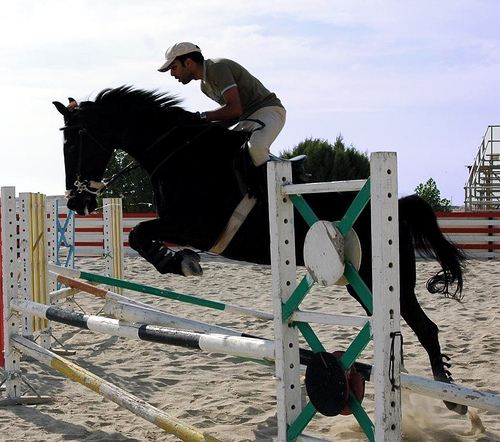

In [ ]:
dataset[0][0]

In [ ]:
target_names = []

for obj in tqdm(dataset):
    target_names.extend([x["name"] for x in obj[1]["annotation"]["object"]])

target_names = list(set(target_names))
target_names

100%|██████████| 5717/5717 [01:00<00:00, 95.02it/s] 


['cow',
 'horse',
 'bus',
 'train',
 'sheep',
 'tvmonitor',
 'bird',
 'pottedplant',
 'car',
 'boat',
 'cat',
 'bottle',
 'diningtable',
 'aeroplane',
 'bicycle',
 'chair',
 'dog',
 'motorbike',
 'person',
 'sofa']

In [ ]:
target2index = {name: i for i, name in enumerate(target_names)}
index2target = {i: name for i, name in enumerate(target_names)}

In [ ]:
def target_transform(voc_target):
    target = {}

    target["boxes"] = torch.tensor(
        [
            [
                float(x["bndbox"]["xmin"]),
                float(x["bndbox"]["ymin"]),
                float(x["bndbox"]["xmax"]),
                float(x["bndbox"]["ymax"])
            ] for x in voc_target["annotation"]["object"]
        ],
        dtype=torch.float32
    )

    target["labels"] = torch.tensor(
        [target2index[x["name"]] for x in voc_target["annotation"]["object"]],
        dtype=torch.int64
    )

    return target

In [ ]:
def show(imgs):
    to_pil = T.ToPILImage()

    if not isinstance(imgs, list):
        imgs = [imgs]
    fix, axs = plt.subplots(ncols=len(imgs), squeeze=False, figsize=(16, 8))

    for i, img in enumerate(imgs):
        img = img.detach()
        img = to_pil(img)
        axs[0, i].imshow(np.asarray(img))
        axs[0, i].set(xticklabels=[], yticklabels=[], xticks=[], yticks=[])

def draw_boxes_single_image(image, boxes, labels):
    colors = ["red" for _ in boxes]
    show(draw_bounding_boxes(image, boxes, labels, colors=colors, width=3))

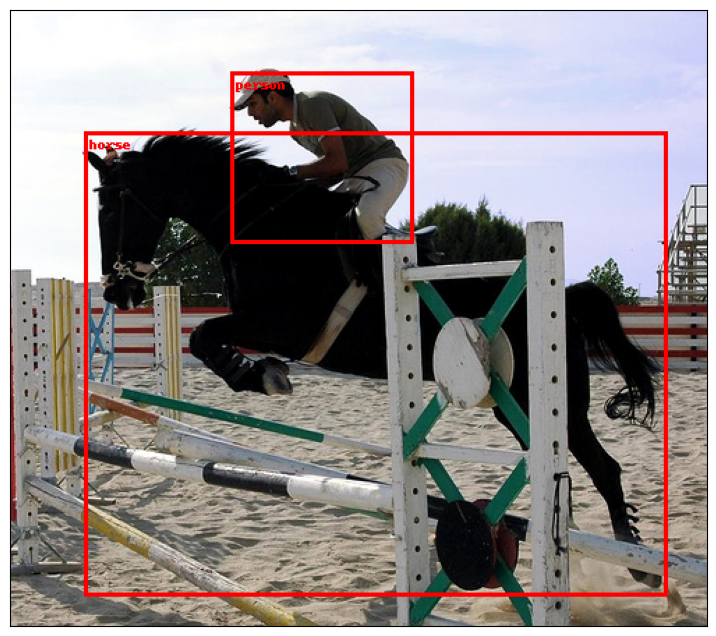

In [ ]:
draw_boxes_single_image(
    T.PILToTensor()(dataset[0][0]),
    target_transform(dataset[0][1])["boxes"],
    [index2target[label.item()] for label in target_transform(dataset[0][1])["labels"]]
)

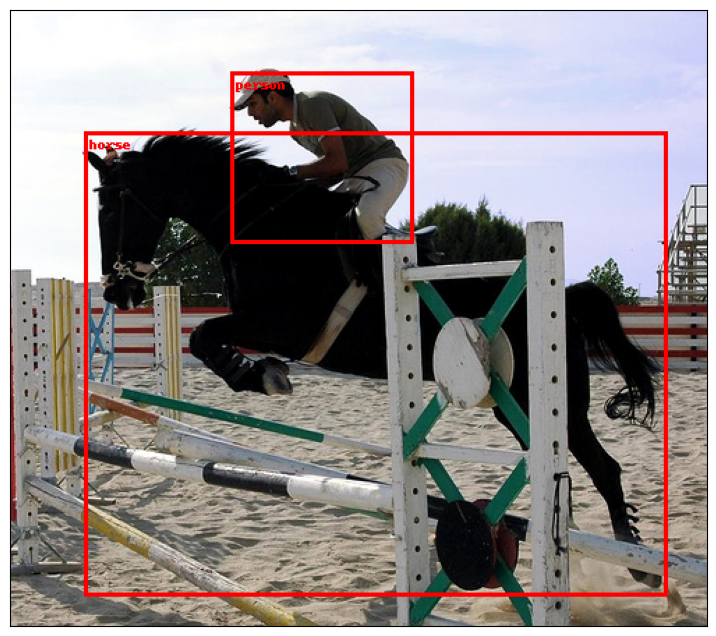

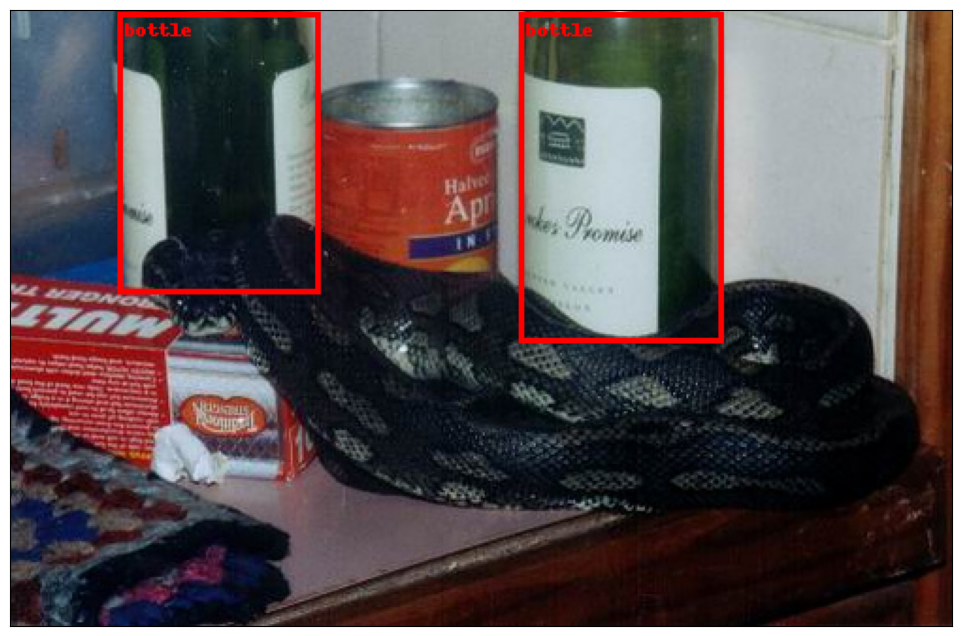

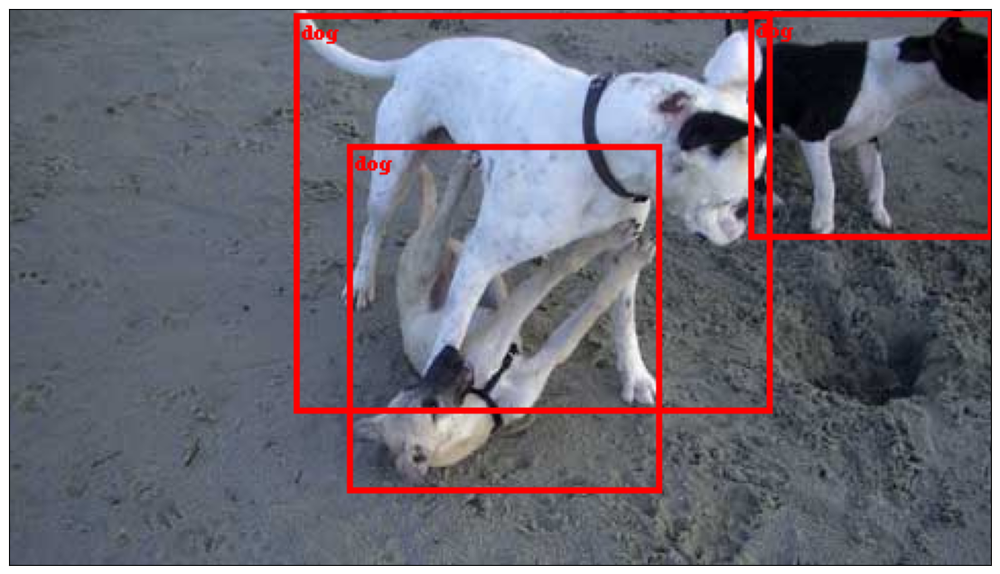

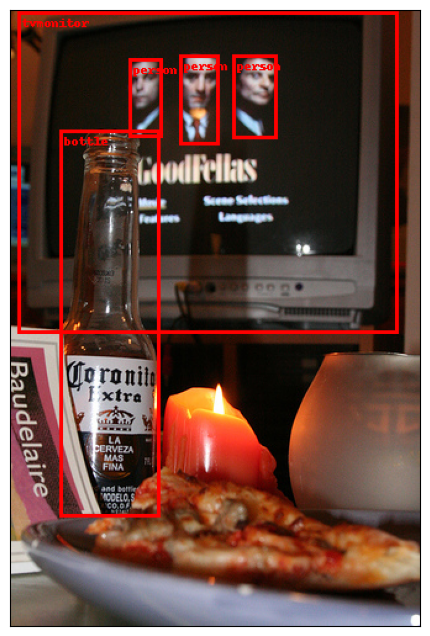

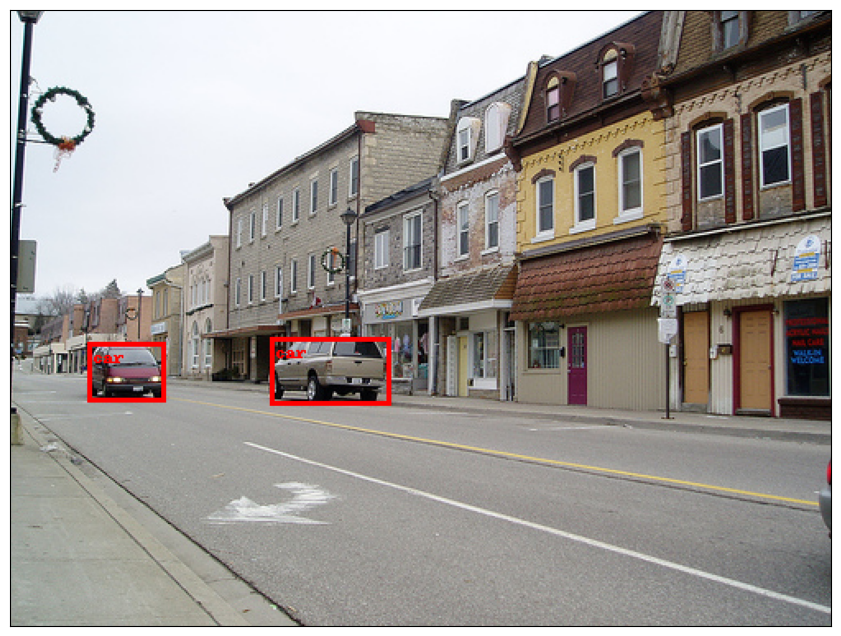

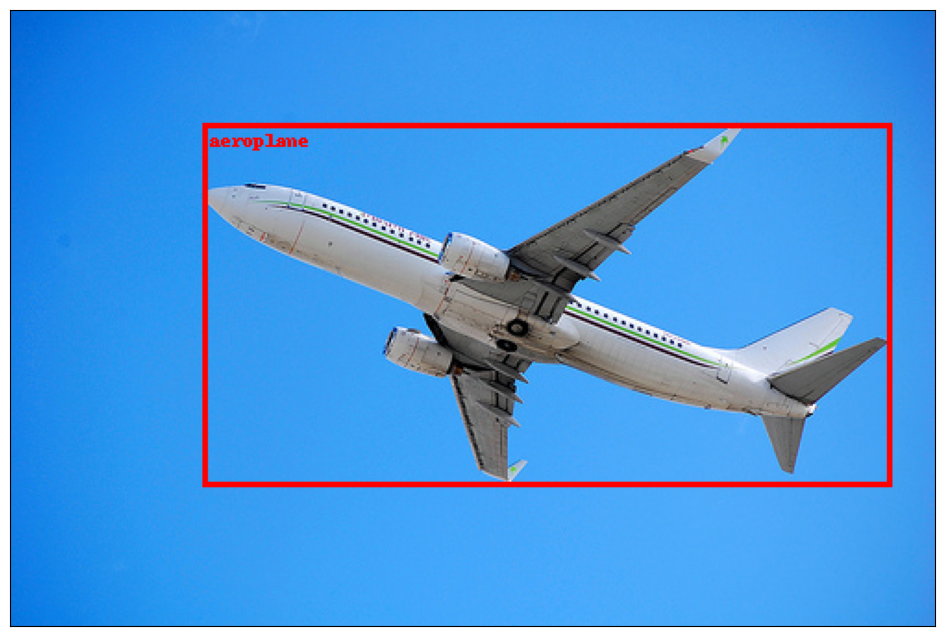

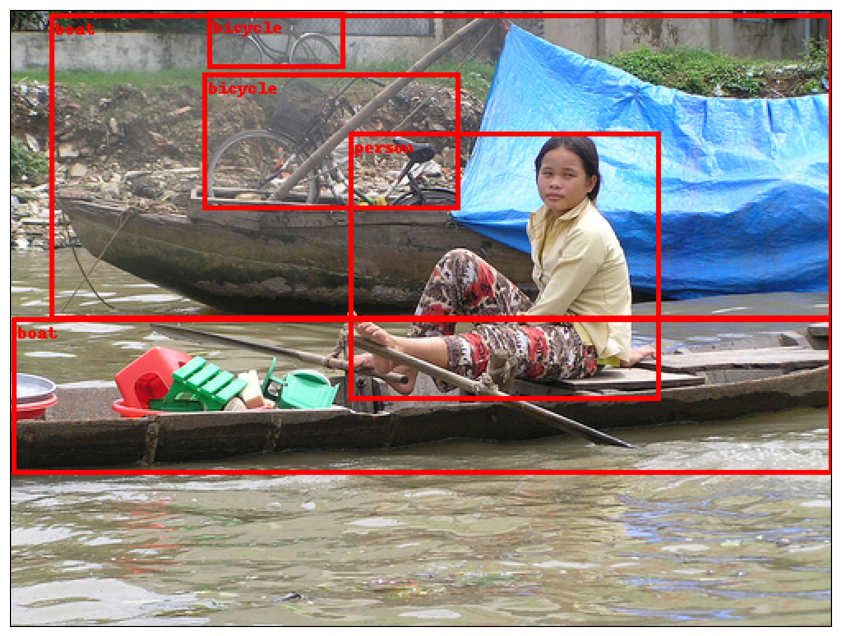

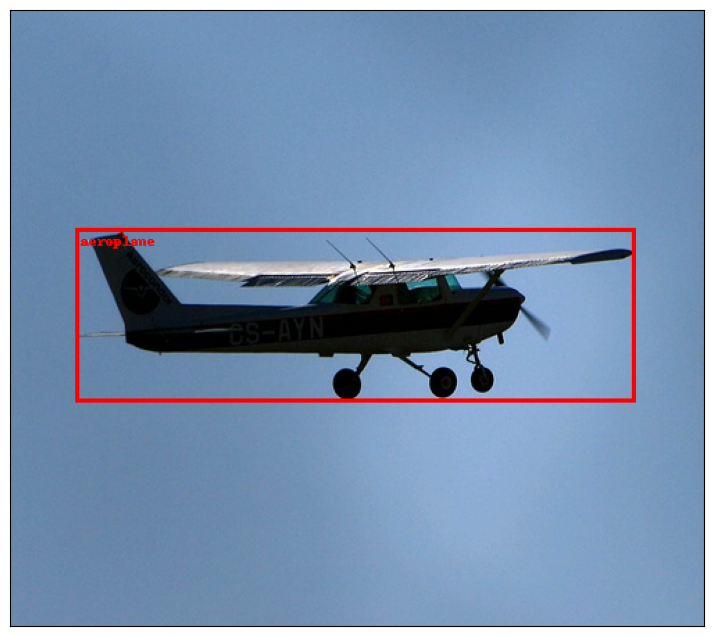

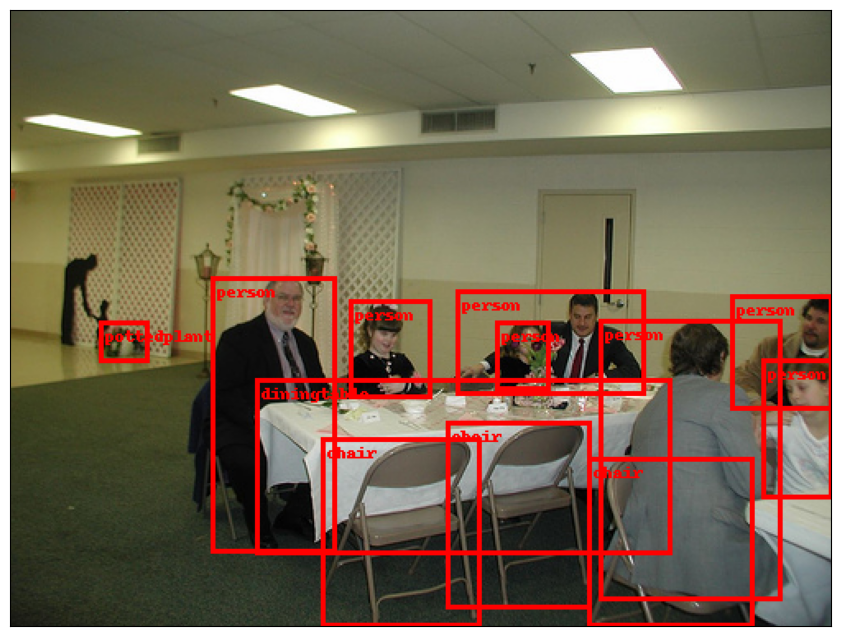

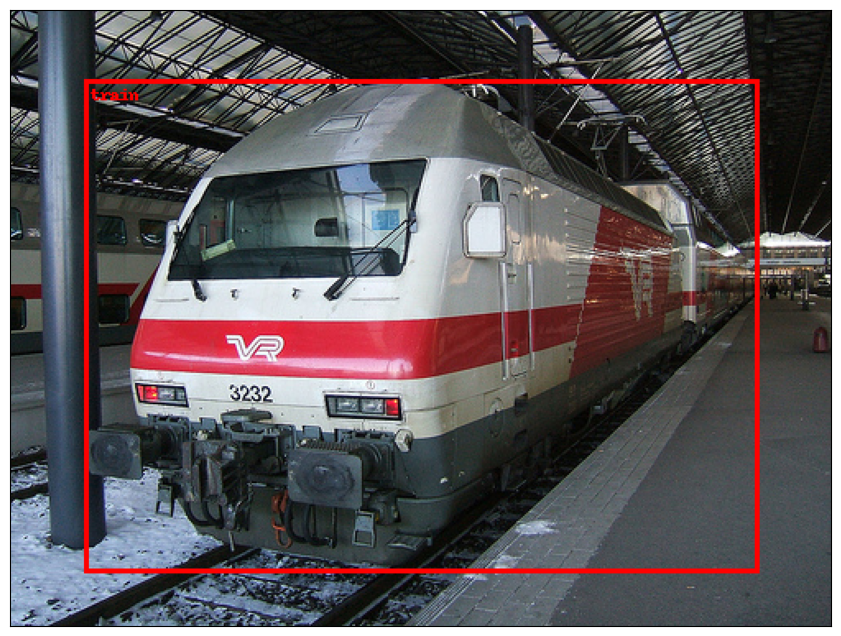

In [ ]:
for i in range(10):
    draw_boxes_single_image(
        T.PILToTensor()(dataset[i][0]),
        target_transform(dataset[i][1])["boxes"],
        [index2target[label.item()] for label in target_transform(dataset[i][1])["labels"]]
    )

In [ ]:
def collate_fn(batch):
    return tuple(zip(*batch))

dataset_train = VOCDetection(
    path,
    image_set="train",
    transform=T.ToTensor(),
    target_transform=target_transform
)

dataset_valid = VOCDetection(
    path,
    image_set="val",
    transform=T.ToTensor(),
    target_transform=target_transform
)

train_loader = DataLoader(dataset_train, batch_size=8, shuffle=True, num_workers=8, pin_memory=True, collate_fn=collate_fn)
valid_loader = DataLoader(dataset_valid,batch_size=8, shuffle=False, num_workers=8, pin_memory=True, collate_fn=collate_fn)

In [ ]:
def get_detection_model():
    model = fasterrcnn_mobilenet_v3_large_320_fpn(pretrained=True)
    model.roi_heads.box_predictor = FastRCNNPredictor(1024, len(target_names))
    return model

In [ ]:
model = get_detection_model()
model

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_MobileNet_V3_Large_320_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_MobileNet_V3_Large_320_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/fasterrcnn_mobilenet_v3_large_320_fpn-907ea3f9.pth" to /tmp/xdg_cache/torch/hub/checkpoints/fasterrcnn_mobilenet_v3_large_320_fpn-907ea3f9.pth
100%|██████████| 74.2M/74.2M [00:00<00:00, 79.4MB/s]


FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(320,), max_size=640, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (0): Conv2dNormActivation(
        (0): Conv2d(3, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
        (1): FrozenBatchNorm2d(16, eps=1e-05)
        (2): Hardswish()
      )
      (1): InvertedResidual(
        (block): Sequential(
          (0): Conv2dNormActivation(
            (0): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=16, bias=False)
            (1): FrozenBatchNorm2d(16, eps=1e-05)
            (2): ReLU(inplace=True)
          )
          (1): Conv2dNormActivation(
            (0): Conv2d(16, 16, kernel_size=(1, 1), stride=(1, 1), bias=False)
            (1): FrozenBatchNorm2d(16, eps=1e-05)
          )
        )
      )
      (2): InvertedResidual(
        (block): 

In [ ]:
def apply_nms(orig_prediction, iou_thresh=0.3):

    keep = batched_nms(orig_prediction["boxes"], orig_prediction["scores"], orig_prediction["labels"], iou_thresh)
    final_prediction = orig_prediction

    final_prediction["boxes"] = final_prediction["boxes"][keep]
    final_prediction["scores"] = final_prediction["scores"][keep]
    final_prediction["labels"] = final_prediction["labels"][keep]

    return final_prediction

In [ ]:
@torch.inference_mode()
def visualize(model, batch):
    model.eval()

    to_pil = T.ToPILImage()
    to_tensor = T.PILToTensor()
    xs, ys = batch

    for i, (x, y) in enumerate(zip(xs, ys)):
        prediction = {k: v.to(device) for k, v in model([x.to(device)])[0].items()}
        prediction = apply_nms(prediction)

        x = to_tensor(to_pil(x.cpu()))

        true_boxes = draw_bounding_boxes(
            x,
            boxes=y["boxes"],
            labels=[index2target[label.item()] for label in y["labels"]],
            colors="red",
            width=3
        )

        predicted_boxes = draw_bounding_boxes(
            x,
            boxes=prediction["boxes"],
            labels=[index2target[label.item()] for label in prediction["labels"]],
            colors="red",
            width=3
        )

        fig, axs = plt.subplots(1, 2, figsize=(16, 8), facecolor="white")

        axs[0].imshow(to_pil(true_boxes))
        axs[1].imshow(to_pil(predicted_boxes))

        axs[0].axis("off")
        axs[1].axis("off")

        axs[0].set_title("Target boxes")
        axs[1].set_title("Predicted boxes")

        plt.subplots_adjust(wspace=0, hspace=0.1)
        plt.show()

        if i >= 9:
            break

In [ ]:
def train(model, train_loader):
    model.train()

    for x, y in tqdm(train_loader, desc="Train"):
        x = list(_.to(device).float() for _ in x)
        y = [{k: v.to(device) for k, v in t.items()} for t in y]
        optimizer.zero_grad()
        output = model(x, y)
        loss_sum = sum(loss for loss in output.values())
        loss_sum.backward()
        optimizer.step()

In [ ]:
@torch.inference_mode()
def evaluate(model, loader):
    model.eval()

    metric = MeanAveragePrecision()

    for x, y in tqdm(loader, desc="Evaluation"):
        x = [_.to(device).float() for _ in x]
        output = model(x)
        output = [{k: v.cpu() for k, v in t.items()} for t in output]
        metric.update(output, y)

    return metric.compute()["map"]

In [ ]:
def whole_train_valid_cycle(model, num_epochs, title):
    batch = next(iter(valid_loader))

    for epoch in range(num_epochs):
        train(model, train_loader)

        clear_output()

        visualize(model, batch)

In [ ]:
device = "cuda" if torch.cuda.is_available() else "cpu"
print(device)
model = get_detection_model().to(device)
optimizer = Adam([p for p in model.parameters() if p.requires_grad], lr=1e-4)

cuda


/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_MobileNet_V3_Large_320_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_MobileNet_V3_Large_320_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


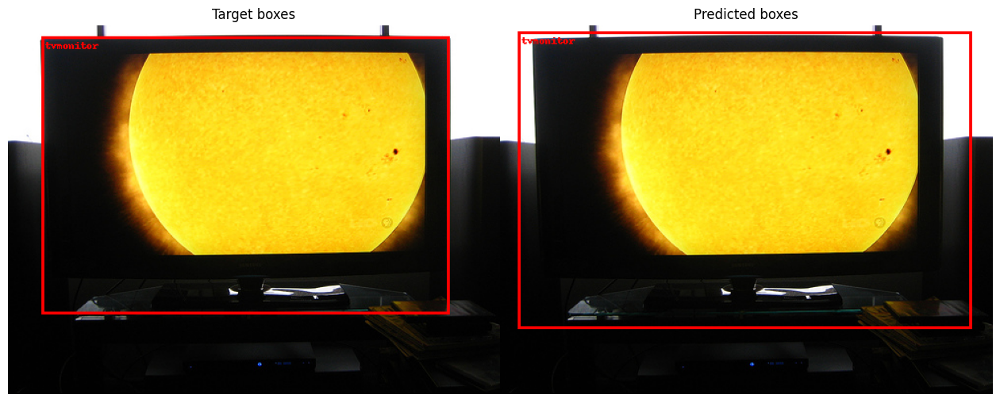

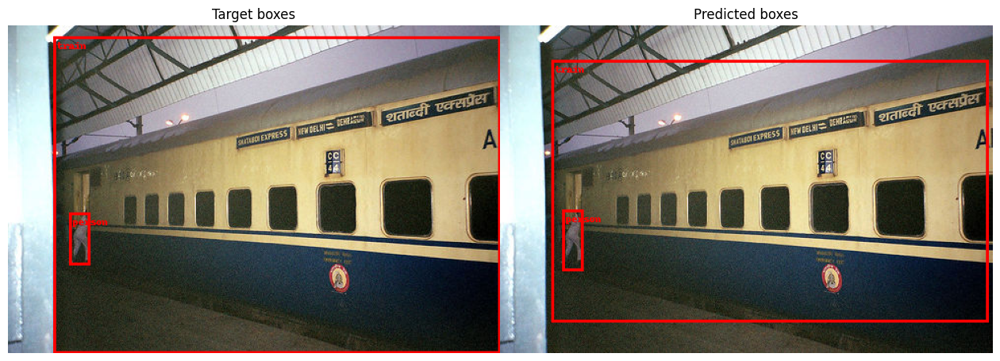

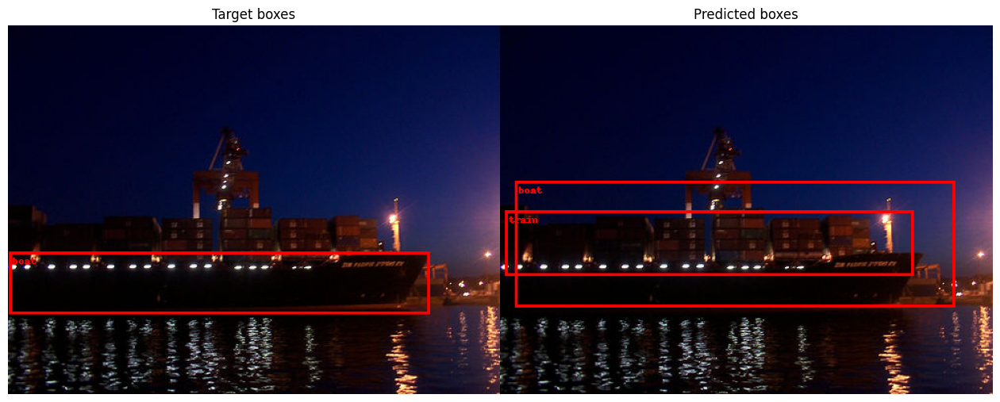

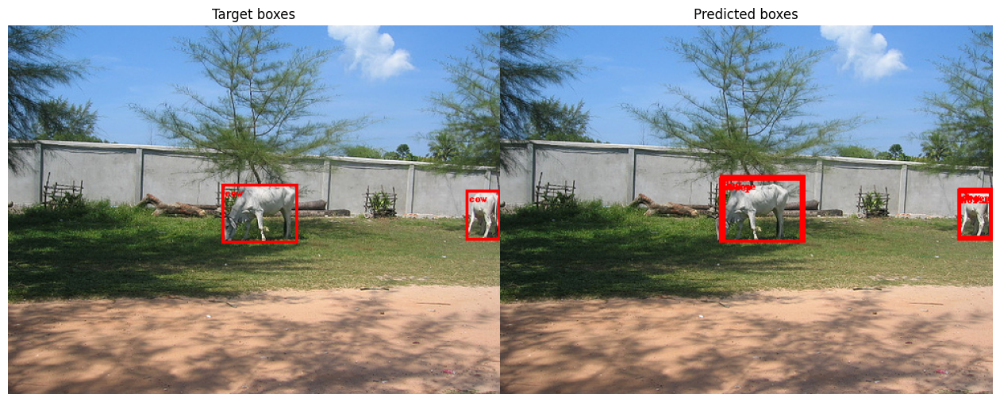

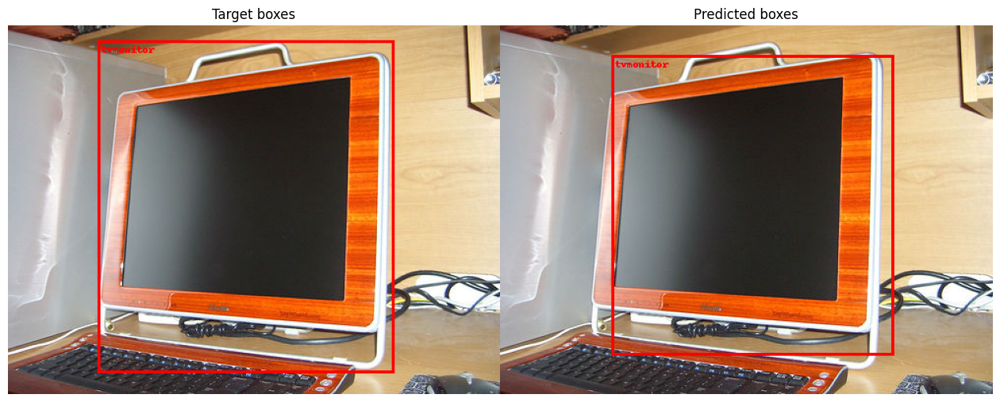

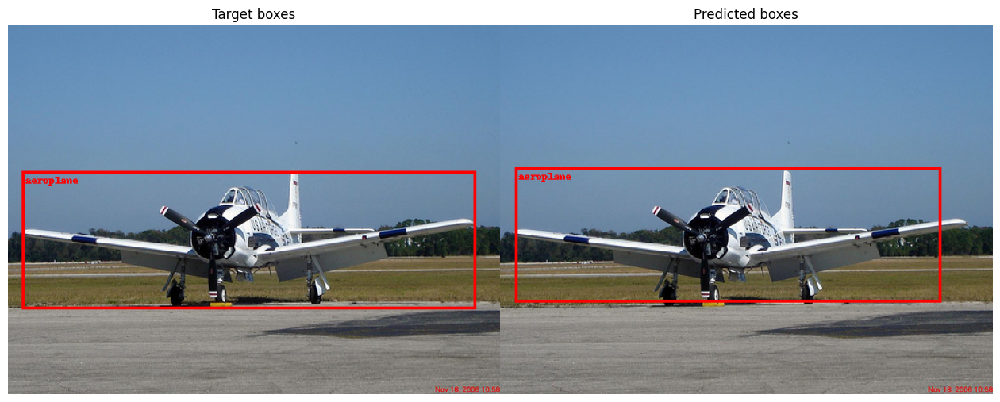

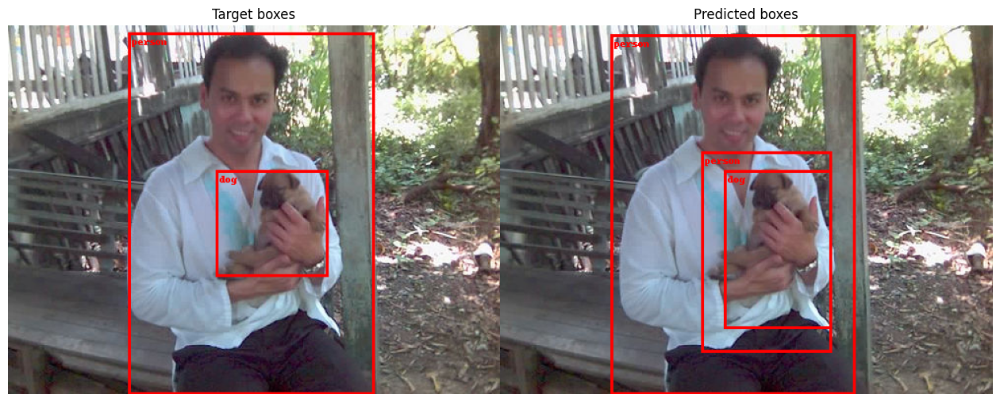

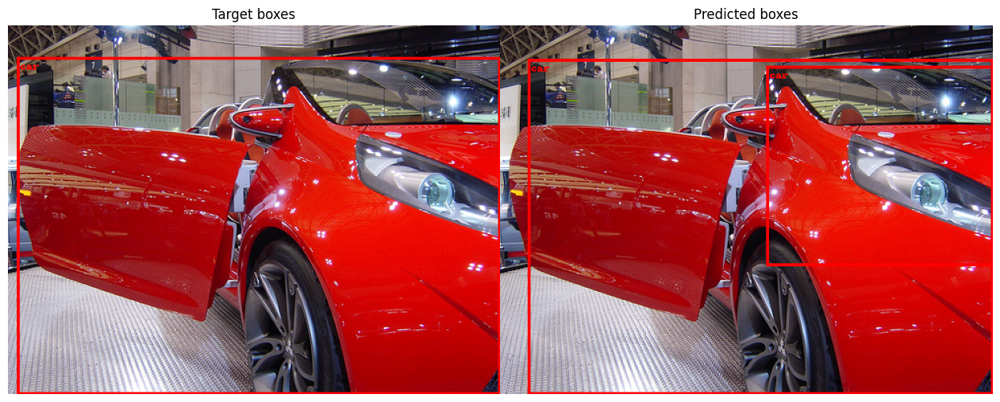

In [ ]:
whole_train_valid_cycle(model, 15, "Faster R-CNN finetune")

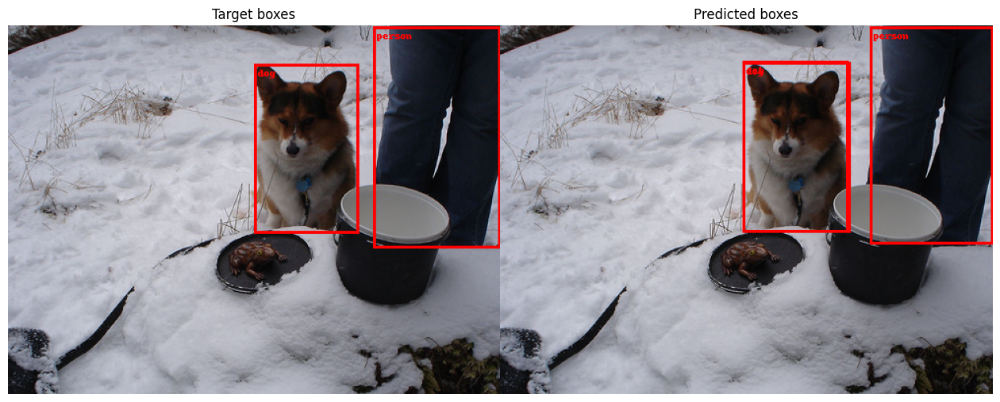

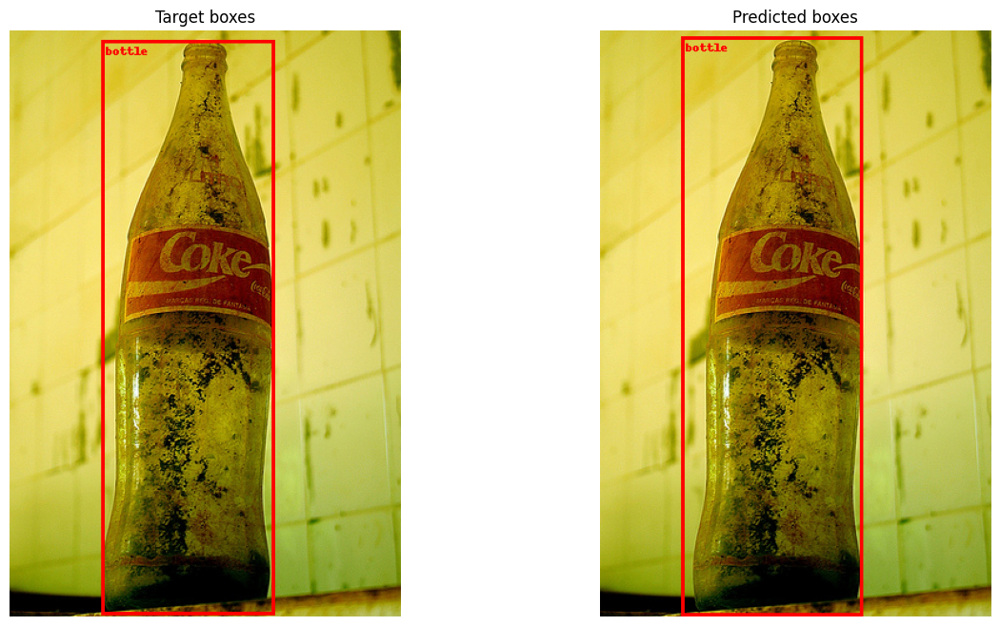

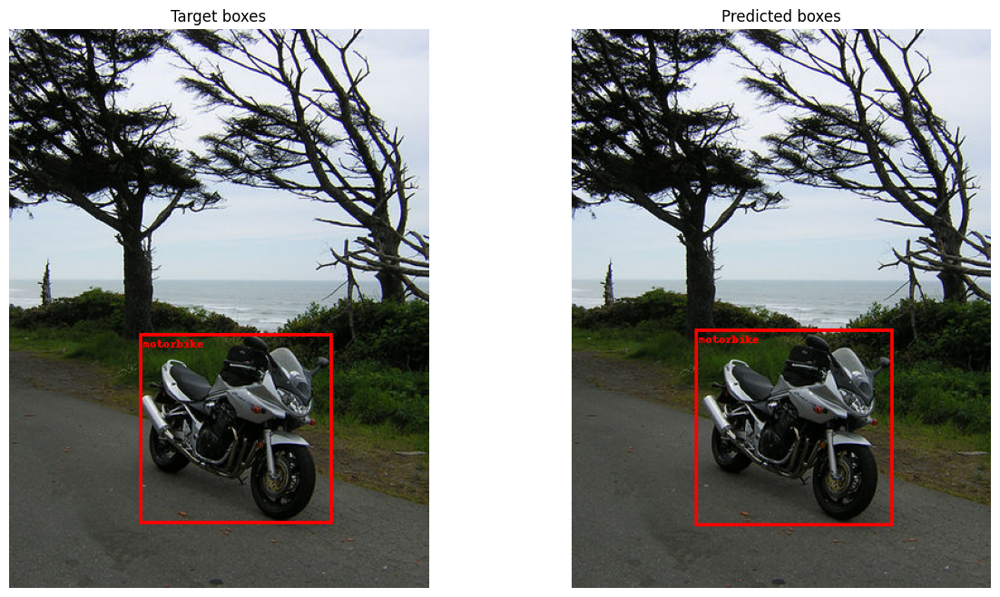

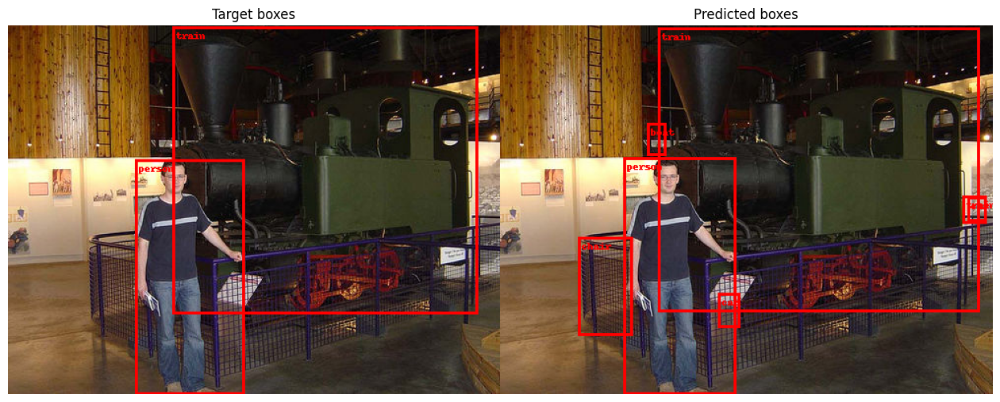

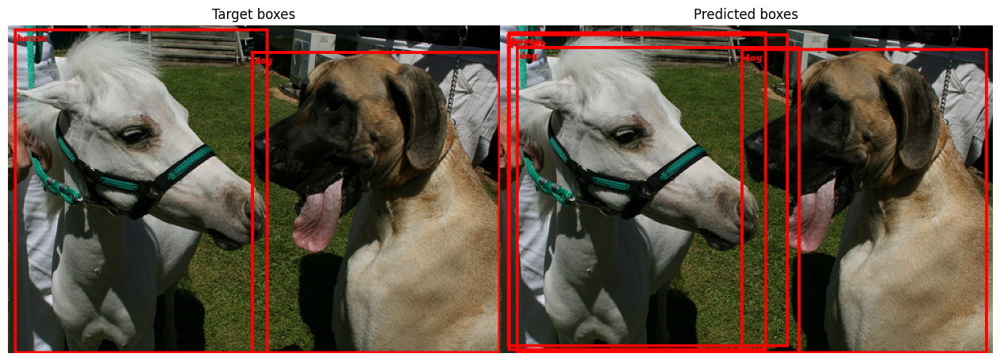

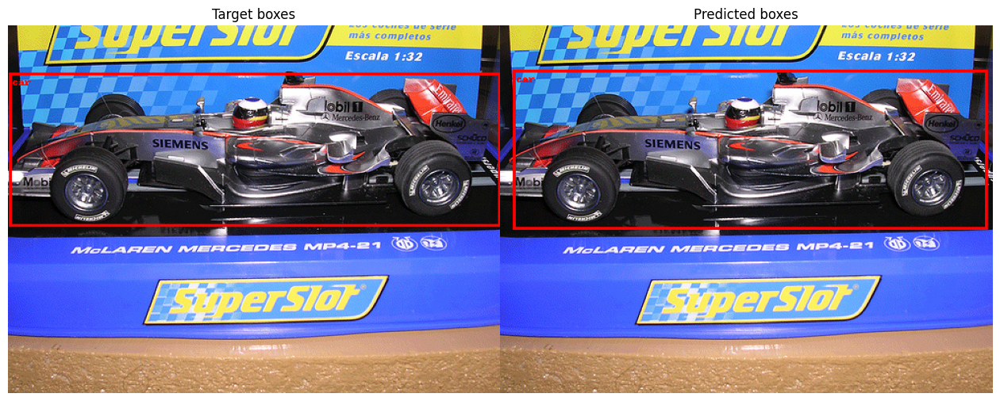

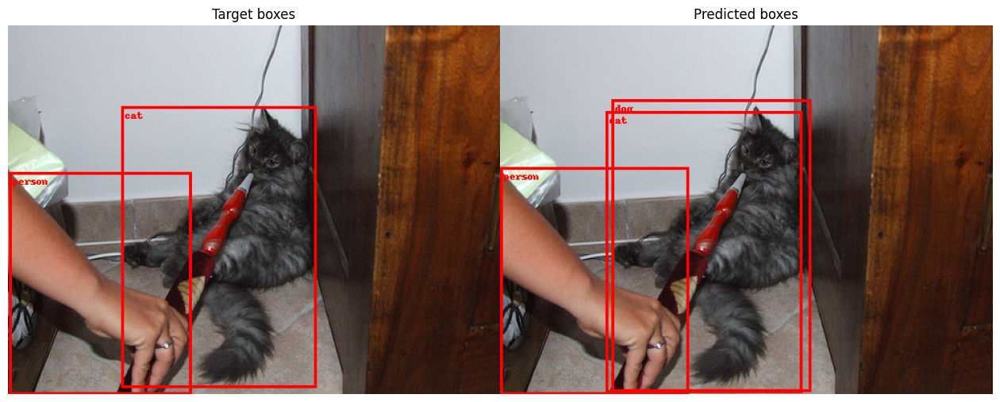

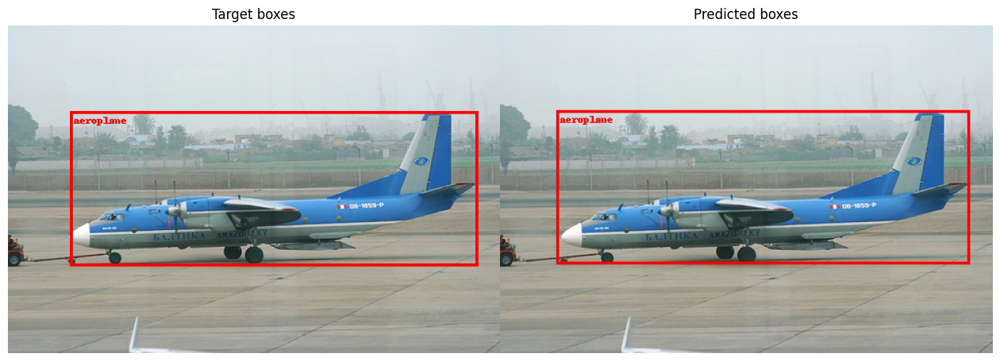

In [ ]:
visualize(model, next(iter(train_loader)))

In [ ]:
train_map = evaluate(model, train_loader)
valid_map = evaluate(model, valid_loader)

print(f"Train mAP {train_map:.5f} Valid mAP {valid_map:.5f}")

Evaluation: 100%|██████████| 728/728 [00:53<00:00, 13.66it/s]


Train mAP 0.67941 Valid mAP 0.36507
